In [1]:
from src.publicLibrary import *
%matplotlib inline

You have imported src


In [2]:
#可以看到在publicLibrary中利用__all__，我们将常用的库import一次，做为公共库
dir()

['In',
 'Out',
 '_',
 '__',
 '___',
 '__builtin__',
 '__builtins__',
 '__doc__',
 '__loader__',
 '__name__',
 '__package__',
 '__spec__',
 '_dh',
 '_i',
 '_i1',
 '_i2',
 '_ih',
 '_ii',
 '_iii',
 '_oh',
 'exit',
 'get_ipython',
 'np',
 'os',
 'pd',
 'plt',
 'quit',
 'sns',
 'sys',
 'wn']

In [3]:
#在__init__.py中利用__all__import所有模块，懒人懒办法
from src import *

you have imported EDA
you have imported tools
you have imported customSample
you have imported featureEngineering
you have imported modelMethod
you have imported modelExplainability
you have imported fileOperation


In [4]:
#importlib包可以用来重新加载模块，当模块代码更新后，可以reload使模块即时生效
import importlib
importlib.reload(fileOperation)

you have imported fileOperation


<module 'src.fileOperation' from '/home/data/fengkong/fangyuan/00_testProject/MachineLearning_pratice/src/fileOperation.py'>

In [5]:
#读取训练、测试集
train,test= fileOperation.get_csv_file_df(train_path='./data/atec_anti_fraud_train.csv',test_path='./data/atec_anti_fraud_test_b.csv',sep=',')
print(train.shape,test.shape)

(994731, 300) (500538, 299)


In [6]:
train.head()

,id,label,date,f1,f2,f3,f4,f5,f6,f7,...,f288,f289,f290,f291,f292,f293,f294,f295,f296,f297
0,f10eb20f31cf7063ee8bdbd1272214e4d7e0193c8dbce4...,0,20171103,0,0,0,0,100807.0,0,5,...,301.0,312.0,328.0,85.0,302.0,201.0,203.0,203.0,61.0,201.0
1,d861929b67938d06538b910b9f6b85f5eb62b6ad7361ba...,0,20170917,0,1,1,1,100805.0,1,5,...,302.0,324.0,391.0,13.0,302.0,160.0,160.0,161.0,8.0,160.0
2,1270cb8a85eedd57672b2c6297fa5633e36773a2c3a351...,0,20171022,0,0,1,0,100102.0,0,6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,9fa009724ee7ff9d688ae321304fbc78f608cdabbfdd2b...,0,20171029,0,0,0,1,100807.0,1,4,...,302.0,322.0,341.0,57.0,251.0,175.0,176.0,176.0,49.0,150.0
4,1da482485d7e8bcefae7e9d0d1167cec3ac111cfa71d8b...,0,20171002,1,1,0,1,100805.0,1,5,...,302.0,301.0,301.0,74.0,302.0,182.0,181.0,182.0,51.0,181.0


浏览数据，共300维，除297维变量外，包含id，label，date，因为互联网数据往往涉及到大量用户行为，样本和变量随时间变化大。 因此可以好好利用date这个变量。翻阅其他同学分享的经验，其中就有根据date去设计cv时的k-折数据集。

In [7]:
#查看label分布
target = 'label'
EDA.label_analysis(train,target=target)

,label,rate
0,977884,98.306376
1,12122,1.218621
-1,4725,0.475003


分布不平衡，先随机抽样；减少分析耗时

In [8]:
importlib.reload(customSample)
sample_size = 100000
sample_train,sample_test = customSample.random_negative_sampling(train=train,test=test,sample_size=sample_size)
sample_train.shape,sample_test.shape

you have imported customSample


((100000, 300), (100000, 299))

In [9]:
# sample_train.to_csv('./data/sample_train.csv',index=False)
# sample_test.to_csv('./data/sample_test.csv',index=False)

In [10]:
# sample_train = pd.read_csv('./data/sample_train.csv')
# sample_test = pd.read_csv('./data/sample_test.csv')

In [11]:
sample_train

,id,label,date,f1,f2,f3,f4,f5,f6,f7,...,f288,f289,f290,f291,f292,f293,f294,f295,f296,f297
124063,ffd6d5672261a41bcdd20455c1c9678afa6a4323bcbe10...,0,20170921,0,1,1,0,100805.0,1,5,...,2.0,3.0,6.0,2.0,1.0,2.0,2.0,2.0,1.0,1.0
794123,0d1d21d3db1339a3604e0ddba54fcf1e0d2e8e870c9e19...,0,20171105,0,1,1,1,100807.0,1,3,...,302.0,309.0,328.0,173.0,302.0,161.0,164.0,163.0,112.0,162.0
708945,4653046a0969092029e3bfbc90a5993d14373dab6c888b...,0,20171019,1,1,0,1,100802.0,0,7,...,302.0,302.0,315.0,62.0,302.0,162.0,162.0,162.0,37.0,162.0
972481,59222058c1d41ba670304967b687923a58f5a72568c04f...,0,20171008,1,0,1,1,100806.0,1,2,...,301.0,308.0,349.0,82.0,302.0,212.0,211.0,211.0,65.0,211.0
414545,80f6f7a1cc9d2d1392798431cc24aac120ce1c4d81f2ce...,0,20171008,0,0,1,1,100803.0,1,6,...,1.0,1.0,1.0,1.0,2.0,2.0,2.0,1.0,1.0,1.0
128529,c2a0f89082a590b5ca94cab510d657a2eb6d625aa0fe22...,0,20171104,0,1,1,1,100807.0,1,1,...,301.0,308.0,317.0,81.0,301.0,197.0,197.0,197.0,59.0,197.0
798236,72f154e274c2208665612887c0c856781ce1569afa3e01...,0,20171011,0,1,0,0,100804.0,1,1,...,2.0,1.0,4.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0
905654,2a0c22d2959a2ffa4fac631bbb74a2fe2f89f796a4475e...,0,20171010,0,0,0,0,100102.0,1,7,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
884293,b219d11799b8df38b71e5714557b792ccb395fc38e93ee...,0,20171009,0,0,1,0,100802.0,0,7,...,2.0,1.0,1.0,2.0,2.0,1.0,1.0,1.0,2.0,2.0
448405,52892bc79ac2e0c3ae212301fdab336f7af31ef985b1b4...,0,20170917,1,0,0,1,100802.0,0,5,...,2.0,2.0,5.0,2.0,1.0,2.0,2.0,1.0,1.0,2.0


In [12]:
cols = sample_train.drop(['id','label','date'],axis=1).columns

In [13]:
importlib.reload(EDA)

you have imported EDA


<module 'src.EDA' from '/home/data/fengkong/fangyuan/00_testProject/MachineLearning_pratice/src/EDA.py'>

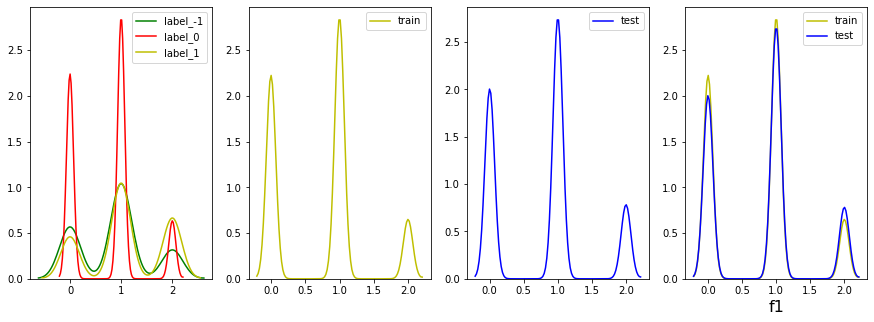

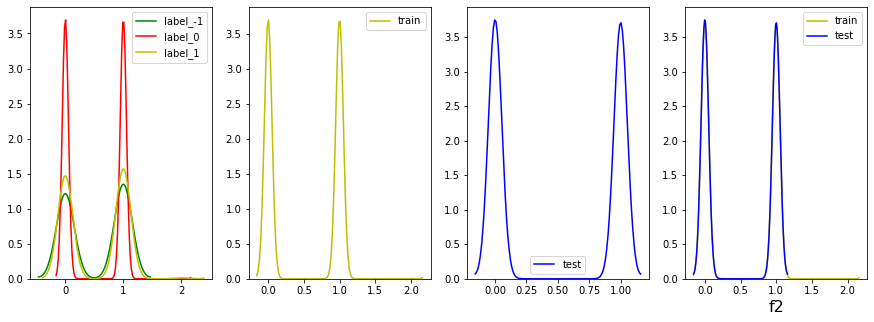

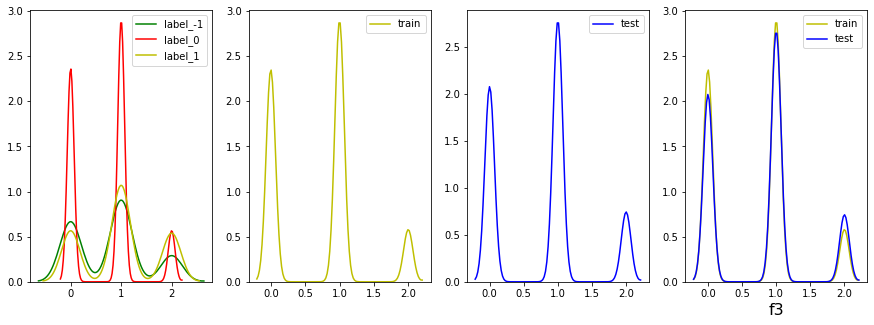

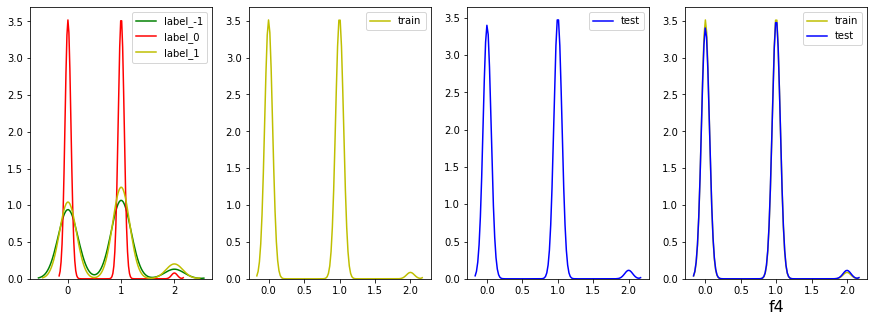

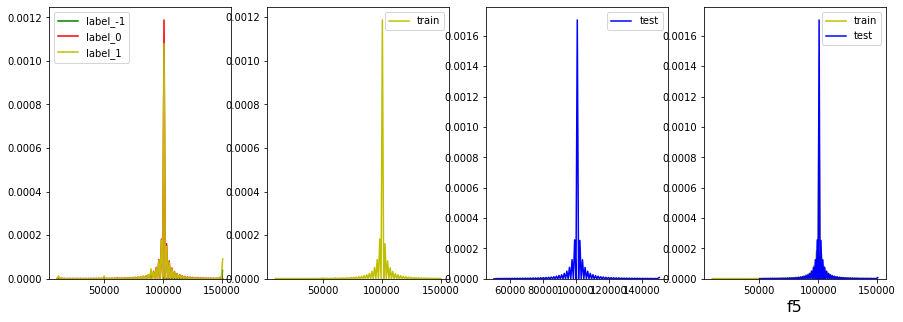

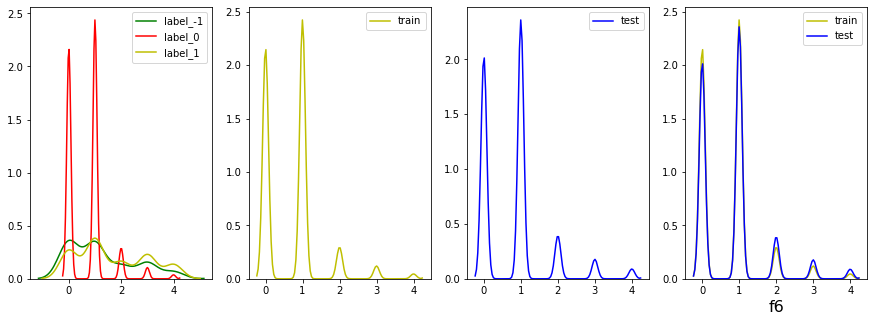

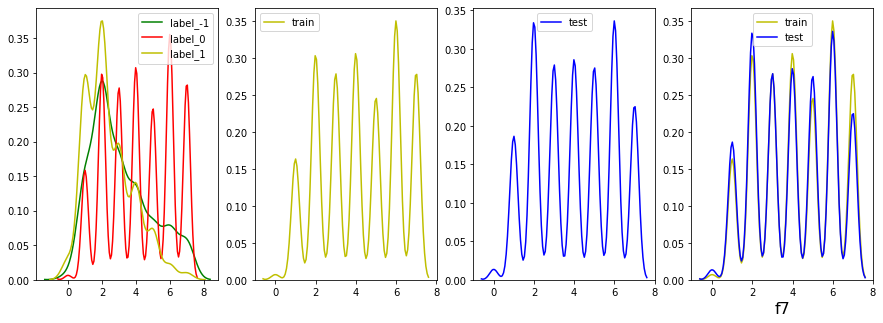

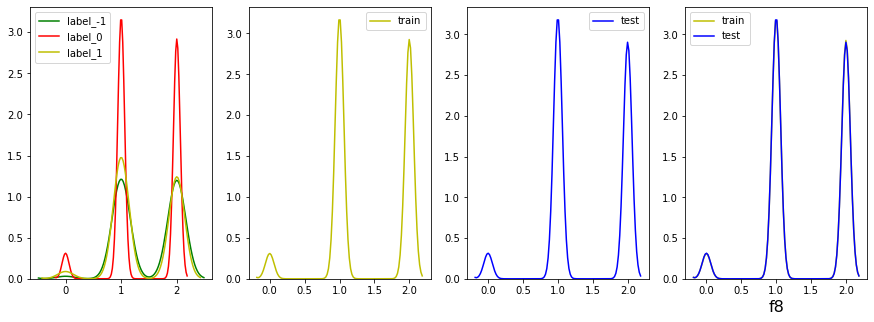

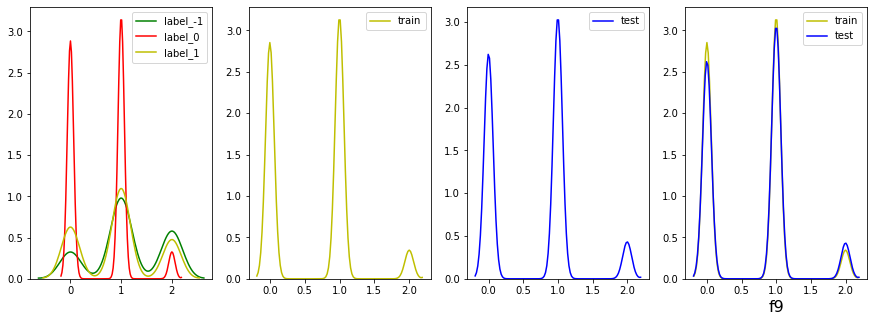

RuntimeError: Selected KDE bandwidth is 0. Cannot estiamte density.

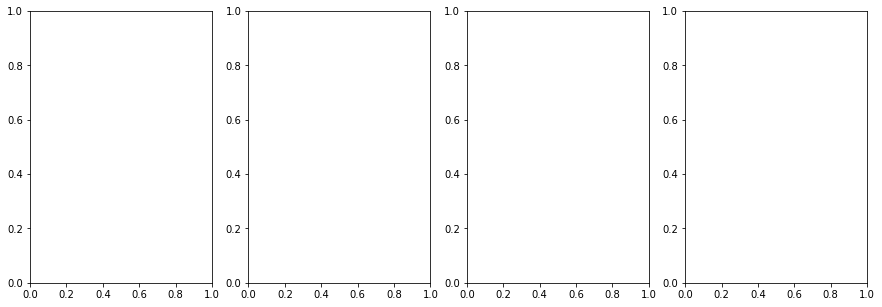

In [14]:
EDA.fea_kde_plot(sample_train,sample_test,fea_cols=cols,target='label',target_list=[-1,0,1])

从kde上可以看出，比如特征：f1，-1和1接近，我们可以认为标签为-1的人，更接近1；

In [15]:
#挑选出前期可以删除的变量,原则：1、无区分能力，看图1；train，test发生较大偏移,比如占比，值域(横轴)，看图2-图4；因为是初筛，不用太严格
del_cols = ['f20','f21','f22','f23','f24','f25','f26','f27','f28','f29','f30','f31','f32','f33','f34','f35',
           'f48','f49','f50','f51','f52','f53','f54','f55','f64','f65','f67','f68','f69','f70','f71','f73',
           'f74','f75','f76','f77','f92','f93','f94','f95','f96','f97','f99','f100','f101','f102','f103',
           'f104','f105','f106','f107','f108','f109','f111','f112','f113','f114','f115','f116','f117','f118',
            'f119','f120','f121','f122','f123','f124','f125','f126','f127','f128','f129','f130','f131','f132',
           'f133','f134','f135','f136','f137','f138','f139','f140','f141','f142','f143','f144','f145','f146',
           'f147','f148','f149','f150','f151','f152','f153','f154','f155','f159','f160','f161','f162','f163','f164']
#值域发生变化的变量，需要特殊处理
change_cols = ['f40','f42','f43','f44','f45','f46','f47','f63','f78','f79','f80','f81','f82','f83','f84','f85',
              'f86','f90','f110','f156','f157','f158']

没有太多精力筛选

筛变量是个体力活，越仔细后续工作越简单
之所以把该步骤放前面，是希望让数据变得易于分析；之所以没有直接用模型筛，是因为模型不够智能，会漏掉有效数据，以防外一

In [16]:
sample_train = sample_train.drop(del_cols,axis=1)
sample_test = sample_test.drop(del_cols,axis=1)

In [17]:
#计算相关性高的变量，虽然树模型对相关性不敏感，但是线上应用中，若入模变量中相关性高，当变量不稳定时，模型更加不稳定；
corr_del = featureEngineering.fea_corr_analysis(sample_train,target='label',exclusion_cols=['id','date'],corr_threshold=0.95)
corr_del

count of train corr del:63


['f241',
 'f209',
 'f293',
 'f206',
 'f44',
 'f292',
 'f232',
 'f216',
 'f218',
 'f287',
 'f297',
 'f229',
 'f230',
 'f250',
 'f296',
 'f212',
 'f220',
 'f247',
 'f248',
 'f45',
 'f242',
 'f251',
 'f219',
 'f244',
 'f286',
 'f231',
 'f237',
 'f240',
 'f280',
 'f252',
 'f225',
 'f217',
 'f245',
 'f227',
 'f215',
 'f213',
 'f228',
 'f284',
 'f295',
 'f249',
 'f294',
 'f285',
 'f266',
 'f243',
 'f238',
 'f224',
 'f208',
 'f288',
 'f281',
 'f222',
 'f214',
 'f253',
 'f233',
 'f226',
 'f223',
 'f246',
 'f283',
 'f211',
 'f221',
 'f165',
 'f205',
 'f289',
 'f290']

In [18]:
train1 = train.drop(del_cols,axis=1)
test1 = test.drop(del_cols,axis=1)

In [131]:
total_res=pd.DataFrame()
total_res['id']=test1.id

In [19]:
importlib.reload(EDA)

you have imported EDA


<module 'src.EDA' from '/home/data/fengkong/fangyuan/00_testProject/MachineLearning_pratice/src/EDA.py'>

In [20]:
#分析超过缺失率阈值的变量
results = EDA.null_fea_analysis(sample_train,target='label',key='id',threshold=0.8)

label      -1      0     1     All     rate    1_rate
f36                                                  
-99999.0  472  91248  1223   92943   92.943  1.315860
1.0         1   3490     4    3495    3.495  0.114449
2.0         2   3543     7    3552    3.552  0.197072
3.0         0     10     0      10    0.010  0.000000
All       475  98291  1234  100000  100.000  1.234000
**************************************************
label      -1      0     1     All     rate    1_rate
f37                                                  
-99999.0  472  91248  1223   92943   92.943  1.315860
1.0         2   3026     3    3031    3.031  0.098977
2.0         1   3541     7    3549    3.549  0.197239
3.0         0    476     1     477    0.477  0.209644
All       475  98291  1234  100000  100.000  1.234000
**************************************************
label      -1      0     1     All     rate    1_rate
f38                                                  
-99999.0  472  91248  1223   92943

label      -1      0     1     All     rate    1_rate
f43                                                  
-99999.0  472  91248  1223   92943   92.943  1.315860
1.0         1   1467     0    1468    1.468  0.000000
2.0         1   2063     2    2066    2.066  0.096805
3.0         1    913     2     916    0.916  0.218341
4.0         0    554     2     556    0.556  0.359712
5.0         0    361     1     362    0.362  0.276243
6.0         0    232     0     232    0.232  0.000000
7.0         0    206     1     207    0.207  0.483092
8.0         0    141     0     141    0.141  0.000000
9.0         0    119     0     119    0.119  0.000000
10.0        0     76     0      76    0.076  0.000000
11.0        0     90     1      91    0.091  1.098901
12.0        0     76     0      76    0.076  0.000000
13.0        0     55     0      55    0.055  0.000000
14.0        0     50     1      51    0.051  1.960784
15.0        0     25     0      25    0.025  0.000000
16.0        0     28     1  

label      -1      0     1     All     rate      1_rate
f46                                                    
-99999.0  472  91248  1223   92943   92.943    1.315860
0.0         1   3514     1    3516    3.516    0.028441
1.0         2   3523     2    3527    3.527    0.056705
2.0         0      5     4       9    0.009   44.444444
3.0         0      1     2       3    0.003   66.666667
6.0         0      0     1       1    0.001  100.000000
7.0         0      0     1       1    0.001  100.000000
All       475  98291  1234  100000  100.000    1.234000
**************************************************
label      -1      0     1     All     rate      1_rate
f47                                                    
-99999.0  472  91248  1223   92943   92.943    1.315860
0.0         0   3459     2    3461    3.461    0.057787
1.0         3   3576     2    3581    3.581    0.055850
2.0         0      8     4      12    0.012   33.333333
3.0         0      0     1       1    0.001  100.0000

从上述数据看出，缺失值与非缺失值之间具有明显区分性，因此暂时不能直接删除缺失列;

在这里进行针对性处理，1、对于数值类别少且有排序的特征，直接填充缺失值；2、对于类别多的特征，2种方式处理，第一种：按缺失值：1，非缺失：0处理；第二种：分箱；

1、'f36','f37';

2、'f38','f39','f40','f41','f42','f43','f44','f45','f46','f47'

In [21]:
EDA.label_analysis(train,target=target)

,label,rate
0,977884,98.306376
1,12122,1.218621
-1,4725,0.475003


In [22]:
#释放内存
import gc
del train,test
gc.collect()

10867

In [23]:
#样本不平衡时,自定义采样
sample_dict = {0:0.1,1:1,-1:1}
train1 = customSample.custom_negative_sampling(train1,target,sample_dict)
train1.shape

(114635, 196)

In [24]:
EDA.label_analysis(train1,target=target)

,label,rate
0,97788,85.303790
1,12122,10.574432
-1,4725,4.121778


In [25]:
#-1为不确定，大概率为坏，处理成1测试
train1['label'] = train1['label'].apply(lambda x: 0 if x==0 else 1)
train1.label.value_counts()

0    97788
1    16847
Name: label, dtype: int64

In [26]:
#直接填充缺失值,并生成新的变量
fill_cols = ['f36','f37','f38','f39']
train1 = featureEngineering.fill_null_directly(train1,fill_cols,fill_value=-99999)
test1 = featureEngineering.fill_null_directly(test1,fill_cols,fill_value=-99999)

In [27]:
#第一种：按缺失值：1，非缺失：0处理；
fill_cols = ['f38','f39','f40','f41','f42','f43','f44','f45','f46','f47']
train1 = featureEngineering.fill_is_null(train1,fill_cols)
test1 = featureEngineering.fill_is_null(test1,fill_cols)

In [28]:
#可以尝试人工分箱和最优分箱同步进行测试

In [29]:
#第二种：分箱,观察label为-1和1的值，进行分箱
bins = [-np.inf,0,3,np.inf]
train1['f38_box'] = pd.cut(train1['f38'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
test1['f38_box'] = pd.cut(test1['f38'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
bins = [-np.inf,0,3,np.inf]
train1['f39_box'] = pd.cut(train1['f39'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
test1['f39_box'] = pd.cut(test1['f39'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
bins = [-np.inf,0,4,np.inf]
train1['f40_box'] = pd.cut(train1['f40'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
test1['f40_box'] = pd.cut(test1['f40'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
bins = [-np.inf,0,6,np.inf]
train1['f41_box'] = pd.cut(train1['f41'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
test1['f41_box'] = pd.cut(test1['f41'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
bins = [-np.inf,0,7,np.inf]
train1['f42_box'] = pd.cut(train1['f42'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
test1['f42_box'] = pd.cut(test1['f42'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
bins = [-np.inf,0,11,np.inf]
train1['f43_box'] = pd.cut(train1['f43'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
test1['f43_box'] = pd.cut(test1['f43'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
bins = [-np.inf,0,11,np.inf]
train1['f44_box'] = pd.cut(train1['f44'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
test1['f44_box'] = pd.cut(test1['f44'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
bins = [-np.inf,0,11,np.inf]
train1['f45_box'] = pd.cut(train1['f45'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
test1['f45_box'] = pd.cut(test1['f45'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
bins = [-np.inf,-1,1,np.inf]
train1['f46_box'] = pd.cut(train1['f46'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
test1['f46_box'] = pd.cut(test1['f46'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
bins = [-np.inf,-1,1,np.inf]
train1['f47_box'] = pd.cut(train1['f47'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])
test1['f47_box'] = pd.cut(test1['f47'].replace(np.nan,-99999),bins=bins,right=True,labels=['A','B','C'])

在这里添加最优分箱

In [30]:
train1

,id,label,date,f1,f2,f3,f4,f5,f6,f7,...,f38_box,f39_box,f40_box,f41_box,f42_box,f43_box,f44_box,f45_box,f46_box,f47_box
818156,b85c6d4e90ab66b95c093e277eb0bf2c6775978f8b98ec...,0,20170918,1,0,2,0,NaN,0,4,...,A,A,A,A,A,A,A,A,A,A
216313,e483a02eebdbd92cc986fbfe04b7ac6969fe4e378101bd...,0,20171005,1,0,1,0,100806.0,0,4,...,C,C,C,B,C,C,C,C,B,B
447308,3bb6f72728a0e2fd7dc8fbbe83fa4f57650e4fc026d631...,0,20171002,1,0,2,0,NaN,2,2,...,A,A,A,A,A,A,A,A,A,A
840192,657a785f7e6f9189f99d15cd185da05ca790cc41d6c114...,0,20171027,1,0,0,1,100802.0,0,6,...,A,A,A,A,A,A,A,A,A,A
493033,50d87f615f5ca6a69103390825a9f7208f0919bcf18de5...,0,20171007,2,0,2,1,NaN,2,2,...,A,A,A,A,A,A,A,A,A,A
550041,192a2cb7df0944c12774ace717804dc371d0ab5e0bc450...,0,20170913,1,0,0,1,100803.0,1,2,...,A,A,A,A,A,A,A,A,A,A
324485,a97de5392d2a2e6c4eb2be74ffa661132747b2d2bb6446...,0,20171030,0,0,0,1,100806.0,0,3,...,A,A,A,A,A,A,A,A,A,A
787081,fd6f33777ed8925aad909ffceea5a953a5deb7eea198d0...,0,20170930,1,0,1,0,61104.0,0,6,...,B,B,B,B,B,B,B,B,B,B
730829,9bb51bc3e710b628064038065381539613c943c8b0bb1c...,0,20171104,1,0,0,1,100807.0,1,2,...,A,A,A,A,A,A,A,A,A,A
602341,b81e7cf1baf27161d24d24bda9600617822f013d8ede3b...,0,20171009,0,0,0,0,100805.0,1,4,...,A,A,A,A,A,A,A,A,A,A


In [31]:
train1.shape,test1.shape

((114635, 220), (500538, 219))

In [32]:
importlib.reload(featureEngineering)
importlib.reload(tools)
timeFeatures = featureEngineering.TimeFeatures()
ts = tools.Tools()

you have imported featureEngineering
you have imported tools


In [33]:
train1['date'] = train1['date'].apply(lambda x:ts.string2time(x,'%Y%m%d'))
test1['date'] = test1['date'].apply(lambda x:ts.string2time(x,'%Y%m%d'))

In [34]:
#衍生时间维度变量
train1 = timeFeatures.tagging_time_fea(df=train1,starttime='date')
test1 = timeFeatures.tagging_time_fea(df=test1,starttime='date')

In [35]:
#缺失值高的行并不能帮助我们识别1，占比少，可以选择删除这部分样本
# row_nan = EDA.get_index_null(train1,threshold=0.8,axis=0)
# train1.iloc[row_nan].label.value_counts()

In [36]:
# train1 = train1.drop(row_nan)
# train1.shape

In [37]:
cat_cols = train1.select_dtypes(include=['category'])
cat_cols = list(cat_cols.columns)
cat_cols

['f38_box',
 'f39_box',
 'f40_box',
 'f41_box',
 'f42_box',
 'f43_box',
 'f44_box',
 'f45_box',
 'f46_box',
 'f47_box',
 'date_hour_box']

处理类别变量
category_encoders库里封装了大量的方法，详见：
https://github.com/scikit-learn-contrib/category_encoders

In [38]:
train1 = train1.reset_index(drop=True)
test1 = test1.reset_index(drop=True)

In [39]:
# sample_train = sample_train.replace(np.nan,-99999)
# sample_test = sample_test.replace(np.nan,-99999)

In [40]:
importlib.reload(featureEngineering)

you have imported featureEngineering


<module 'src.featureEngineering' from '/home/data/fengkong/fangyuan/00_testProject/MachineLearning_pratice/src/featureEngineering.py'>

In [41]:
X_train = train1.drop(['id','date','label'],axis=1)
y_train = train1[['label']]
X_test = test1.drop(['id','date'],axis=1)
print(X_train.shape,X_test.shape)

X_train,X_test = featureEngineering.CategoryEncoders(encoder=1).applying_categoryEncoders(X_train,X_test,cat_cols)

(114635, 239) (500538, 239)


有时候在前面步骤中没有剔除变化大的特征，会报错，所有最好清洗过；另一种办法就是用全量数据fit，再transform；个人倾向于把变化大的特征事先剔除;

模型线上运行时随着时间推移，个人认为已经发生偏移的变量，依然会持续或阶段性发生变化，不建议入模型

In [42]:
X_test

,f1,f2,f3,f4,f5,f6,f7,f8,f9,f10,...,date_is_month_start,date_is_month_end,date_is_day_high,date_hour_box_0,date_hour_sin,date_day_sin,date_dayofweek_sin,date_quarter_sin,date_month_sin,date_weekofyear_sin
0,0,0,1,1,100810.0,0,4,2,0,1,...,False,False,0,1,0.0,0.848644,0.000000,1.0,1.000000,0.926690
1,0,0,1,1,100810.0,1,6,1,0,2,...,False,False,0,1,0.0,0.571268,-0.974928,1.0,1.000000,0.875735
2,0,0,1,1,100811.0,1,2,1,0,1,...,False,False,0,1,0.0,-0.848644,0.000000,1.0,0.866025,0.875735
3,1,0,1,0,100811.0,0,5,1,2,1,...,False,False,0,1,0.0,0.988468,0.974928,1.0,0.866025,0.652822
4,0,0,1,1,100811.0,1,7,1,1,2,...,False,False,0,1,0.0,-0.848644,0.000000,1.0,0.866025,0.875735
5,1,1,0,0,100109.0,1,7,2,0,1,...,False,False,0,1,0.0,-0.897805,0.974928,1.0,0.866025,0.812487
6,2,0,1,1,NaN,4,1,1,1,1,...,False,False,0,1,0.0,0.394356,-0.433884,1.0,1.000000,0.875735
7,0,1,0,0,100808.0,0,2,1,1,1,...,False,False,0,1,0.0,-0.968077,0.433884,1.0,0.866025,0.812487
8,0,0,1,1,100811.0,1,2,2,0,0,...,False,False,0,1,0.0,-0.651372,0.000000,1.0,0.866025,0.812487
9,1,1,0,0,100811.0,0,5,2,1,1,...,False,False,0,1,0.0,0.724793,-0.781831,1.0,1.000000,0.875735


In [43]:
cols = ['f41_box']
civ = featureEngineering.get_iv(train1,cols=cols,target='label',outputfile='./data/feature_detail_iv_list.csv')
civ

-------------process discrete variable:f41_box--------------
f41_box


,var_name,split_list,sub_total_sample_num,positive_sample_num,negative_sample_num,sub_total_num_percentage,positive_rate_in_sub_total,woe_list,iv_list,iv
0,f41_box,[B],6815,202,6613,0.05945,0.029640,-1.729895,0.096244,0.099468
1,f41_box,"[A, C]",107820,16645,91175,0.94055,0.154378,0.057958,0.003225,0.099468


In [44]:
tmp = pd.concat([X_train,y_train],axis=1)
tmp = tmp.replace(np.nan,-99999)
cols = ['f41']
civ = featureEngineering.get_iv(tmp,cols=cols,target='label')
civ

---------------process discrete variable:f41----------------
f41


,var_name,split_list,sub_total_sample_num,positive_sample_num,negative_sample_num,sub_total_num_percentage,positive_rate_in_sub_total,woe_list,iv_list,iv
0,f41,[12.0],15,0,15,0.000131,0.000000,-10.159768,0.001558,0.112347
1,f41,"[15.0, 16.0]",18,0,18,0.000157,0.000000,-10.342088,0.001904,0.112347
2,f41,"[14.0, 19.0]",6,0,6,0.000052,0.000000,-9.243487,0.000567,0.112347
3,f41,"[17.0, 18.0, 23.0, 26.0]",8,0,8,0.000070,0.000000,-9.531165,0.000780,0.112347
4,f41,"[27.0, 28.0, 30.0, 31.0]",4,0,4,0.000035,0.000000,-8.838030,0.000361,0.112347
5,f41,[2.0],3113,64,3049,0.027156,0.020559,-2.105055,0.057638,0.112347
6,f41,[1.0],2349,53,2296,0.020491,0.022563,-2.010001,0.040870,0.112347
7,f41,[3.0],830,46,784,0.007240,0.055422,-1.077136,0.005695,0.112347
8,f41,"[-99999.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0,...",108292,16684,91608,0.944668,0.154065,0.055561,0.002974,0.112347


In [45]:
tmp = pd.concat([X_train,y_train],axis=1)
tmp = tmp.replace(np.nan,-99999)
cols = ['f41_box_1']
civ = featureEngineering.get_iv(tmp,cols=cols,target='label')
civ

------------process discrete variable:f41_box_1-------------
f41_box_1


,var_name,split_list,sub_total_sample_num,positive_sample_num,negative_sample_num,sub_total_num_percentage,positive_rate_in_sub_total,woe_list,iv_list,iv
0,f41_box_1,[1],7073,220,6853,0.0617,0.031104,-1.680185,0.095807,0.0992
1,f41_box_1,[0],107562,16627,90935,0.9383,0.154581,0.059512,0.003393,0.0992


可以看到，原始变量f41，iv几乎为0，而f41_box_1，iv提升到0.1；这条对比结果是在对train进行随机抽样后的分析结果；
可以看到，在执行custom_negative_sampling后，变量iv显著提升，分箱操作并没有提升iv；

In [46]:
importlib.reload(featureEngineering)
customFeatureSelector = featureEngineering.CustomFeatureSelector()
feat_importances = customFeatureSelector.randomForestSelectFeas(X_train.replace(np.nan,-99999),y_train,is_fit=True)

you have imported featureEngineering


In [47]:
feat_importances

,feature,important
105,f210,0.033190
6,f7,0.030919
154,f259,0.029719
156,f261,0.028631
104,f209,0.026808
131,f236,0.025154
159,f264,0.023686
155,f260,0.023181
130,f235,0.022148
157,f262,0.021587


In [48]:
feat_importances_tops = feat_importances[feat_importances.important>=0.005]
feat_importances_tops

,feature,important
105,f210,0.033190
6,f7,0.030919
154,f259,0.029719
156,f261,0.028631
104,f209,0.026808
131,f236,0.025154
159,f264,0.023686
155,f260,0.023181
130,f235,0.022148
157,f262,0.021587


In [49]:
len(feat_importances_tops)

55

In [50]:
feat_importances_tops = list(feat_importances_tops['feature'].values)
X_train_select = X_train[feat_importances_tops]
X_test_select = X_test[feat_importances_tops]
X_train_select.shape

(114635, 55)

In [54]:
modelExplainability.genderate_PermutationImportance(X_train_select.replace(np.nan,-99999),y_train)

In [55]:
perm_feature_importance = modelExplainability.get_permutation_feature_imp(is_test=True,imp_threshold=0)

In [56]:
perm_feature_importance

,feature,imp_x,imp_y
0,f7,0.054152,0.038621
1,f6,0.020709,0.011433
2,f210,0.012953,0.010846
3,f234,0.009690,0.009119
4,f248,0.006555,0.005961
5,f238,0.006423,0.006031
6,f209,0.005346,0.005897
7,f262,0.004073,0.003379
8,f247,0.003689,0.004100
9,f235,0.003569,0.005641


In [57]:
feat_importances_perm = list(perm_feature_importance['feature'].values)
X_train_select = X_train_select[feat_importances_perm]
X_test_select = X_test_select[feat_importances_perm]
X_train_select.shape

(114635, 55)

https://www.kaggle.com/dansbecker/shap-values
以下是一些由可解释性带来的好处：

可靠性

易于调试

启发特征工程思路

指导后续数据搜集

指导人为决策

建立信任

In [65]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
train_X, val_X, train_y, val_y = train_test_split(X_train_select.replace(np.nan,-99999), y_train,test_size=0.3,random_state=1)
model = RandomForestClassifier(n_estimators=200, random_state=1).fit(train_X, train_y)

In [79]:
shapTreeExplainer = modelExplainability.ShapTreeExplainer(model,val_X)

In [75]:
# shapTreeExplainer = ShapTreeExplainer(model,val_X)
iloc = 0
shapTreeExplainer.shap_force_plot(iloc)

 50%|==========          | 1/2 [01:09<01:09]       

Done!


100%|===================| 199/200 [144:27<00:43]        

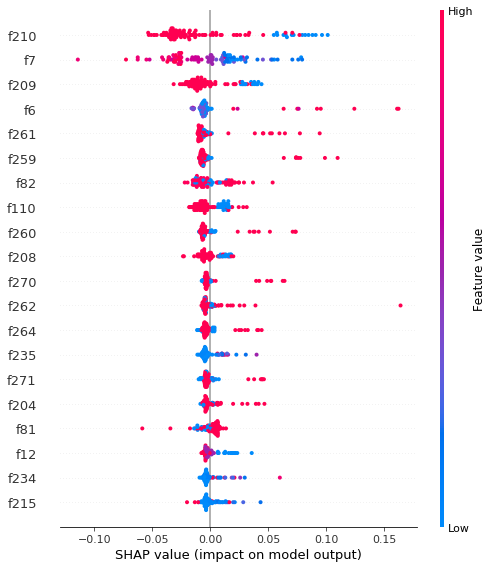

In [80]:
shapTreeExplainer.shap_summary_plot(100)

In [159]:
shap_values[0]

array([[ 1.42549541e-02,  3.36634078e-03, -1.99557858e-02, ...,
        -5.59529640e-02, -9.08816748e-02,  3.47004248e-04],
       [-1.20814573e-02,  8.65176429e-03,  1.86291924e-02, ...,
         5.99926068e-03,  6.15407424e-03,  7.95177140e-04],
       [-1.48545910e-02,  8.03358081e-03,  1.99133065e-02, ...,
         5.58071755e-03,  7.53417961e-03,  4.91411802e-04],
       ...,
       [ 1.31060984e-01, -5.67285203e-02, -3.94485967e-02, ...,
        -7.29886836e-04,  4.22735186e-03, -1.22797359e-03],
       [ 2.54178990e-02,  6.97944268e-03,  1.45201087e-02, ...,
         4.98941119e-03,  5.07120742e-03,  5.42982974e-04],
       [ 1.25538060e-01,  2.28679763e-02, -3.71225168e-02, ...,
         3.73832248e-03,  4.41602408e-03,  3.81415600e-05]])

In [85]:
# 基本值(base_value)是我们传入数据集上模型预测值的均值，可以通过自己计算来验证：
y_base = shapTreeExplainer.explainer.expected_value
print(y_base)

pred = model.predict(val_X.replace(np.nan,-99999))
print(pred.mean())

[0.85208921 0.14791079]
0.1357913407577564


In [84]:
shapTreeExplainer.shap_values

AttributeError: 'ShapTreeExplainer' object has no attribute 'shap_values'

In [176]:
#鼠标可以放图上面显示具体数值
shap.force_plot(shapTreeExplainer.explainer.expected_value[1], shapTreeExplainer.shap_values[1], val_X[:10000])

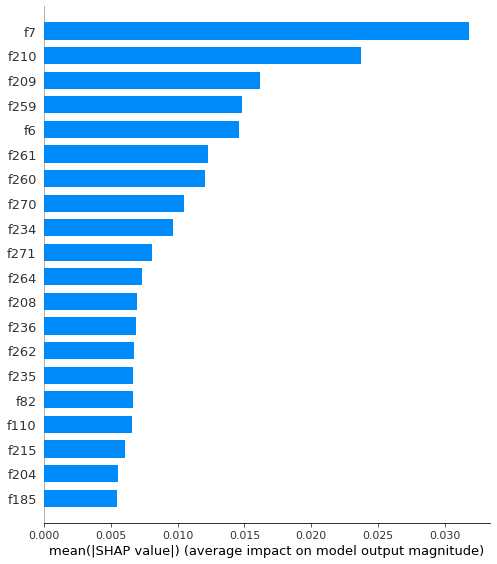

In [180]:
#Feature Importance
# SHAP提供了另一种计算特征重要性的思路。
# 取每个特征的SHAP值的绝对值的平均值作为该特征的重要性，得到一个标准的条形图(multi-class则生成堆叠的条形图)
shap.summary_plot(shap_values[1], val_X[:10000], plot_type="bar",layered_violin_max_num_bins=20)

In [181]:
# interaction value是将SHAP值推广到更高阶交互的一种方法。
# 实现了快速、精确的两两交互计算，这将为每个预测返回一个矩阵，其中主要影响在对角线上，交互影响在对角线外。
# 这些数值往往揭示了有趣的隐藏关系(交互作用)
shap_interaction_values = explainer.shap_interaction_values(X)
shap.summary_plot(shap_interaction_values, X)

In [ ]:
# dependence_plot
# 为了理解单个feature如何影响模型的输出，我们可以将该feature的SHAP值与数据集中所有样本的feature值进行比较。
# 由于SHAP值表示一个feature对模型输出中的变动量的贡献，下面的图表示随着特征RM变化的预测房价(output)的变化。
# 单一RM(特征)值垂直方向上的色散表示与其他特征的相互作用，为了帮助揭示这些交互作用，“dependence_plot函数”
# 自动选择另一个用于着色的feature。在这个案例中，RAD特征着色强调了RM(每栋房屋的平均房间数)对RAD值较高地区的房价影响较小。
# create a SHAP dependence plot to show the effect of a single feature across the whole dataset
# interaction_index :“auto”, None, int, or string
shap.dependence_plot(ind="RM", shap_values=shap_values, features=X,interaction_index='RAD')

In [ ]:
class FeatureProcess:
    '''
     FeatureProcess function class
     
     Arguments:
     
    '''
    def CutBinning(self,df,cols):
        col_bins = {}
        def getBins(df,col,bin_size=10):
            value_min = df[col].min()
            value_max = df[col].max()
            bins = np.linspace(value_min,value_max,bin_size)
            bins = np.insert(bins,0,-np.inf)
            bins = np.append(bins,np.inf)
            return bins
        for col in cols:
            bins = getBins(df,col,bin_size=10)
            col_bins[col] = bins
        return col_bins

In [ ]:
#调用函数参数示例
ddd = FeatureProcess()
col_bins = ddd.CutBinning(x, feature_select)
col_bins

In [ ]:
for key,value in col_bins.items():
    x[key+'_bin'] = pd.cut(x[key],bins=value)
    test_x[key+'_bin'] = pd.cut(test_x[key],bins=value)
    x[key+'_bin'] = x[key+'_bin'].astype('str')
    test_x[key+'_bin'] = test_x[key+'_bin'].astype('str')

In [125]:
x = X_train_select
y = y_train

In [96]:
model_params = {
            'learning_rate':(0.05, 0.1),
            'max_bin':(10,255),
            'num_leaves':(10,35),
            'n_estimators': (100, 300),
            'max_depth': (2, 13),
            'min_split_gain':(1,5),
            'colsample_bytree':(0.9,1.0),
            'subsample':(0.5,1.0),
            'reg_alpha':(0.1,5.0),
            'reg_lambda':(100,800),
            'min_child_weight':(0.01,0.1),
            'min_child_samples':(10,100)
        }

In [99]:
importlib.reload(modelMethod)
bayesoptModel = modelMethod.BayesoptModel(x,y,scoring='roc_auc',cv=5)
model_bo_max = bayesoptModel.start_bayes_opt(model_params)

you have imported modelMethod
|   iter    |  target   | colsam... | learni... |  max_bin  | max_depth | min_ch... | min_ch... | min_sp... | n_esti... | num_le... | reg_alpha | reg_la... | subsample |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        |  0.9693   |  0.9982   |  0.06994  |  93.24    |  7.355    |  53.38    |  0.09242  |  1.172    |  204.4    |  23.82    |  1.29     |  167.9    |  0.9533   |
|  2        |  0.9678   |  0.9561   |  0.0832   |  71.95    |  12.57    |  78.29    |  0.0784   |  4.423    |  145.3    |  20.32    |  2.41     |  210.5    |  0.9377   |
|  3        |  0.9643   |  0.9782   |  0.05775  |  180.7    |  6.378    |  20.9     |  0.09418  |  3.29     |  156.6    |  24.11    |  0.8972   |  457.2    |  0.9946   |
|  4        |  0.9679   |  0.9201   |  0.07325  |  229.5    |  9.073    |  67.01    |  0.03928  |  4.98     |  171.7    

|  29       |  0.9718   |  0.9555   |  0.05729  |  183.0    |  12.68    |  18.74    |  0.09472  |  1.77     |  252.9    |  30.19    |  0.8273   |  106.9    |  0.7494   |
|  30       |  0.971    |  0.9442   |  0.05689  |  142.8    |  12.54    |  41.06    |  0.07582  |  3.589    |  293.5    |  33.61    |  0.1101   |  262.7    |  0.6818   |


In [100]:
model_bo_max

{'target': 0.9731297183050405,
 'params': {'colsample_bytree': 0.9262904746031471,
  'learning_rate': 0.09528243872594415,
  'max_bin': 175.04178034407676,
  'max_depth': 12.820947158564824,
  'min_child_samples': 18.004173468309524,
  'min_child_weight': 0.023925539917265724,
  'min_split_gain': 1.0356853619918747,
  'n_estimators': 287.59040522779634,
  'num_leaves': 33.88561307196911,
  'reg_alpha': 0.8863819471520255,
  'reg_lambda': 281.6474447655926,
  'subsample': 0.5348574606477878}}

In [101]:
#bayes_opt版本更新经常容易报错，有时需要修改代码
#可以适当手动调参
params = model_bo_max['params']
params['max_bin'] = int(params['max_bin'])
params['num_leaves'] = int(params['num_leaves'])
params['n_estimators'] = int(params['n_estimators'])
params['max_depth'] = int(params['max_depth'])
# params['min_split_gain'] = int(params['min_split_gain'])
params['reg_lambda'] = int(params['reg_lambda'])
params['min_child_samples'] = int(params['min_child_samples'])

In [102]:
model_base = LGBMClassifier(**params)
np.mean(cross_val_score(model_base, x, y, cv=5, scoring='roc_auc'))

0.9691886170554179

In [103]:
model_base.fit(x,y)
print('auc_score:',roc_auc_score(y,model_base.predict_proba(x)[:,1]))

auc_score: 0.9765946011826597


In [104]:
def feval_spec(y, preds):
    from sklearn.metrics import roc_curve
    fpr, tpr, threshold = roc_curve(y, preds)
    tpr0001 = tpr[fpr <= 0.001].max()
    tpr001 = tpr[fpr <= 0.005].max()
    tpr005 = tpr[fpr <= 0.01].max()
    #tpr01 = tpr[fpr.values <= 0.01].max()
    tprcal = 0.4 * tpr0001 + 0.3 * tpr001 + 0.3 * tpr005
    return tprcal

In [126]:
x = x.reset_index(drop=True)
y = y.reset_index(drop=True)

In [ ]:
from sklearn.model_selection import StratifiedKFold
skf=StratifiedKFold(n_splits=10,random_state=2019)
skf.get_n_splits(x,y)
print(skf)
train_predict_proba=pd.DataFrame()
test_predict_proba=pd.DataFrame()
i = 0
for train_index,test_index in skf.split(x,y):
    i +=1
#     print("Train Index:",train_index,",Test Index:",test_index)
    X_train,X_test=x.loc[train_index],x.loc[test_index]
    y_train,y_test=y.loc[train_index],y.loc[test_index]
    model_base.fit(X_train,y_train)
#     print('auc_score:',roc_auc_score(y,model_base.predict_proba(x)[:,1]))
    train_metric=feval_spec(y_train,model_base.predict_proba(X_train)[:,1])
    valid_metri=feval_spec(y_test,model_base.predict_proba(X_test)[:,1])
    print("The ",i," times res: train set spe_val:",train_metric,", validation set sep_val: ",valid_metri)
    train_predict_proba = pd.concat([train_predict_proba,pd.DataFrame(model_base.predict_proba(x)[:,1])],axis=1)
    test_predict_proba = pd.concat([test_predict_proba,pd.DataFrame(model_base.predict_proba(X_test_select)[:,1])],axis=1)
train_predict_proba_mean = train_predict_proba.mean(axis=1)
print(feval_spec(y,train_predict_proba_mean))

total_res["score"] = test_predict_proba.mean(axis=1)
# total_res.to_csv("result.csv",index=False)

StratifiedKFold(n_splits=10, random_state=2019, shuffle=False)
The  1  times res: train set spe_val: 0.34310117398760054 , validation set sep_val:  0.26498516320474774
The  2  times res: train set spe_val: 0.3426131117266851 , validation set sep_val:  0.2886053412462908
The  3  times res: train set spe_val: 0.336512333465242 , validation set sep_val:  0.27554896142433233
The  4  times res: train set spe_val: 0.33180319219100385 , validation set sep_val:  0.3275370919881305
The  5  times res: train set spe_val: 0.3445455744624719 , validation set sep_val:  0.28451038575667653
The  6  times res: train set spe_val: 0.3413506562025984 , validation set sep_val:  0.28752969121140143
The  7  times res: train set spe_val: 0.33876541581481234 , validation set sep_val:  0.34881235154394297
